# Explorative Datenanalyse Part 4

Winkel innerhalb einer gegebenen Sequenz (Bindungen berücksichtigt) streuen annährend normalverteilt. Wir können daher Mittelwerte bilden und nur diese analysieren. \
Die Abweichung von Mittelwert und Median ist marginal, es spielt zunächst keine Rolle was von beiden wir betrachten.

Die Daten aggregiert nach Sequenz werden mit `engineer.add_features.save_agg_df` erzeugt/gespeichert und mit `engineer.add_features.load_agg_df` geladen:

In [1]:
from config import *
agg = load_agg_df(way=None)  # Set way=3, 4, ... to load only that looptype
df = load_data('_cleaned_L2_with_chains')  # Contains chain label/organism

`explore.macro_eda` enthält Funktionen um aggregierte Daten zu visualisieren:

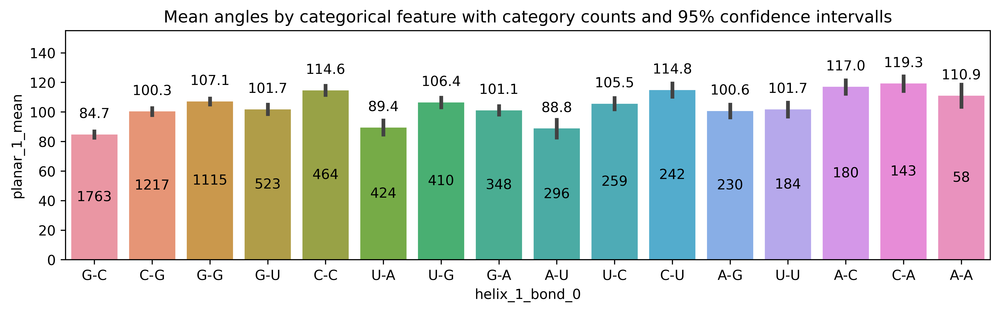

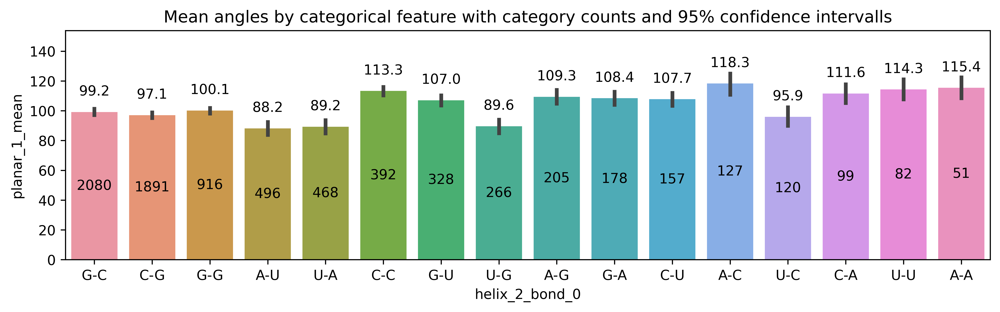

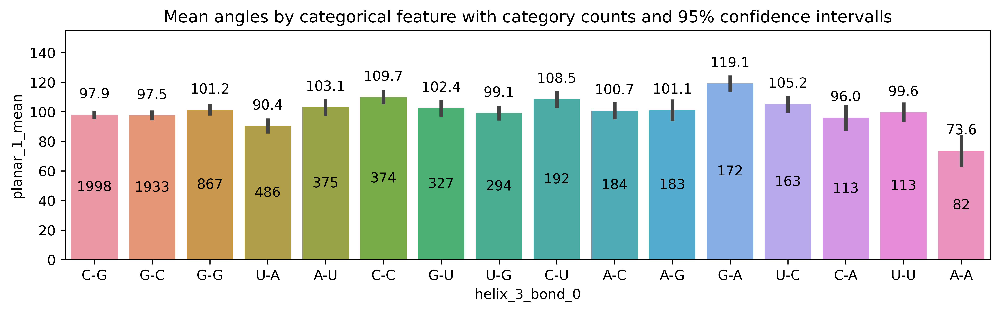

In [2]:
feature_barplot(agg, 'helix_1_bond_0', feature='planar_1_mean')
feature_barplot(agg, 'helix_2_bond_0', feature='planar_1_mean')
feature_barplot(agg, 'helix_3_bond_0', feature='planar_1_mean')

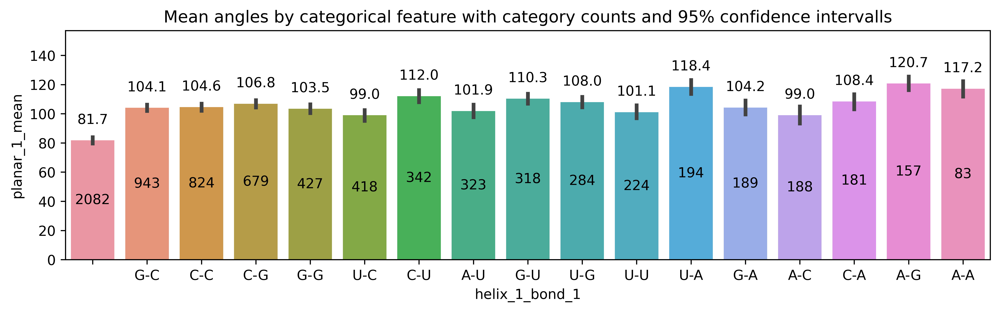

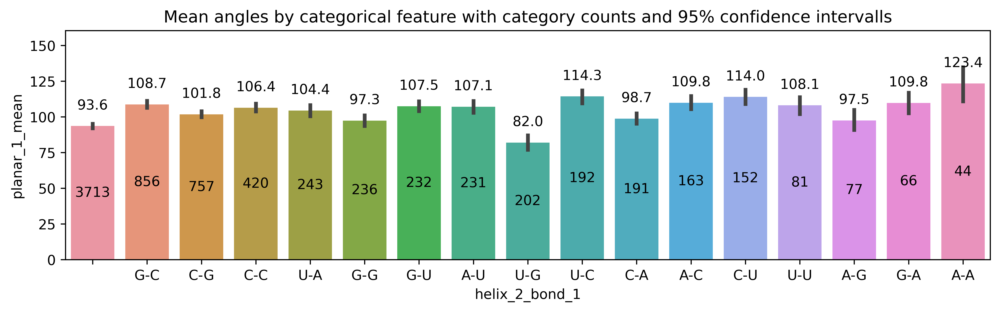

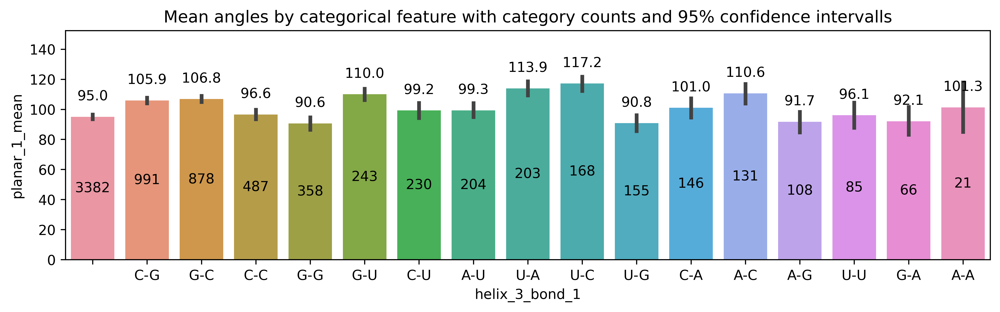

In [3]:
feature_barplot(agg, 'helix_1_bond_1', feature='planar_1_mean')
feature_barplot(agg, 'helix_2_bond_1', feature='planar_1_mean')
feature_barplot(agg, 'helix_3_bond_1', feature='planar_1_mean')

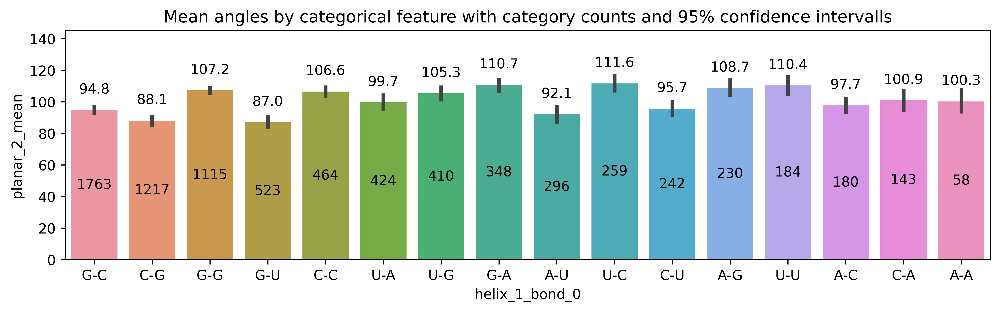

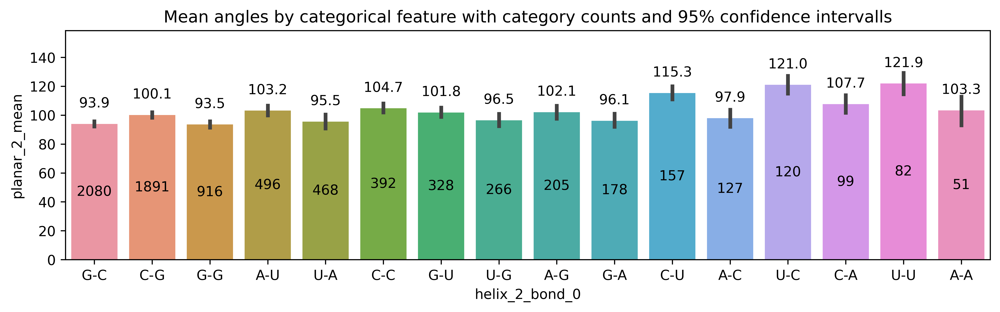

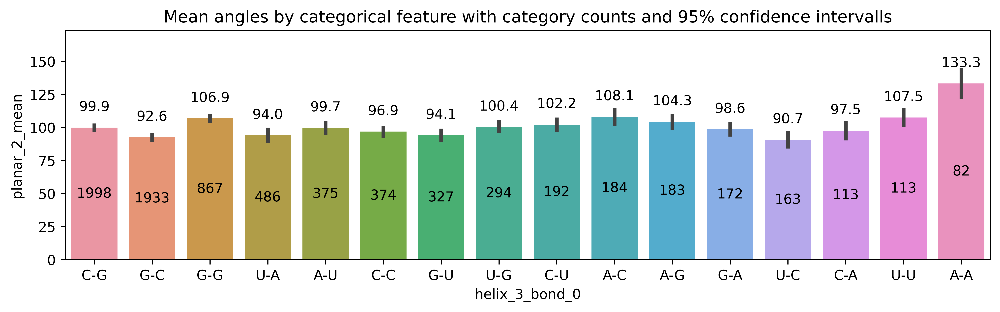

In [4]:
feature_barplot(agg, 'helix_1_bond_0', feature='planar_2_mean')
feature_barplot(agg, 'helix_2_bond_0', feature='planar_2_mean')
feature_barplot(agg, 'helix_3_bond_0', feature='planar_2_mean')

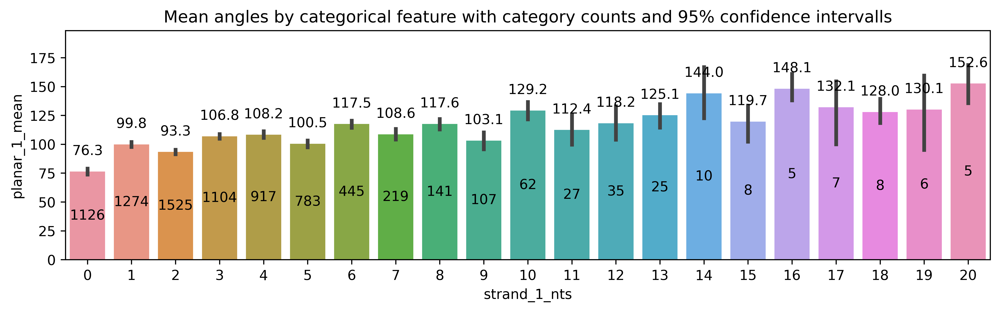

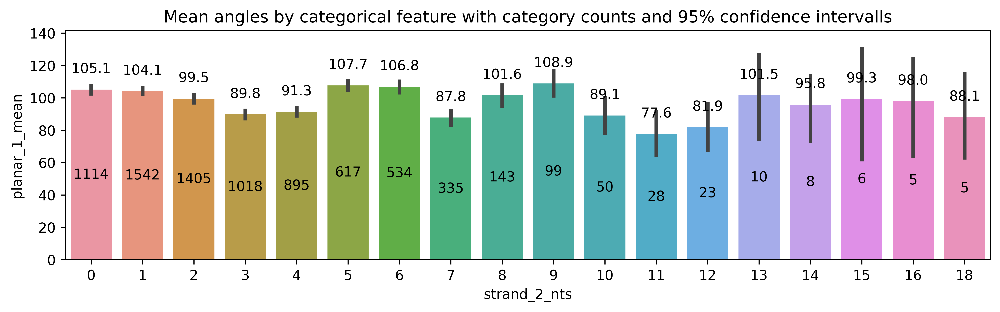

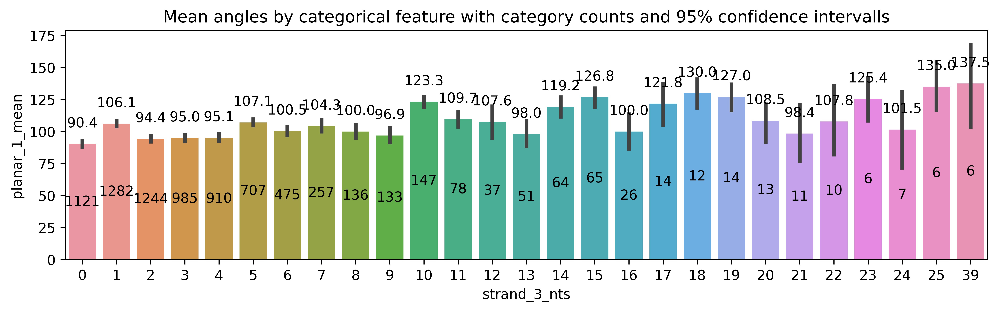

In [5]:
feature_barplot(agg, 'strand_1_nts', feature='planar_1_mean')
feature_barplot(agg, 'strand_2_nts', feature='planar_1_mean')
feature_barplot(agg, 'strand_3_nts', feature='planar_1_mean')

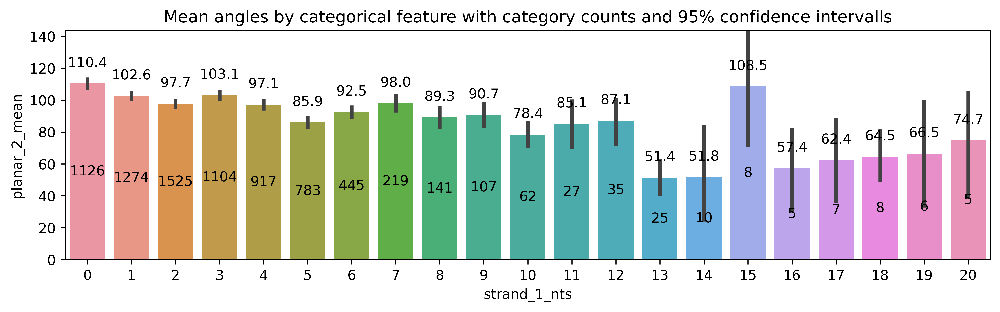

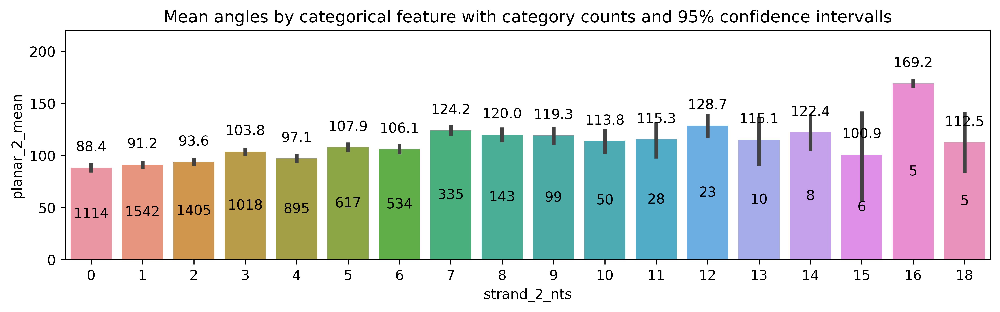

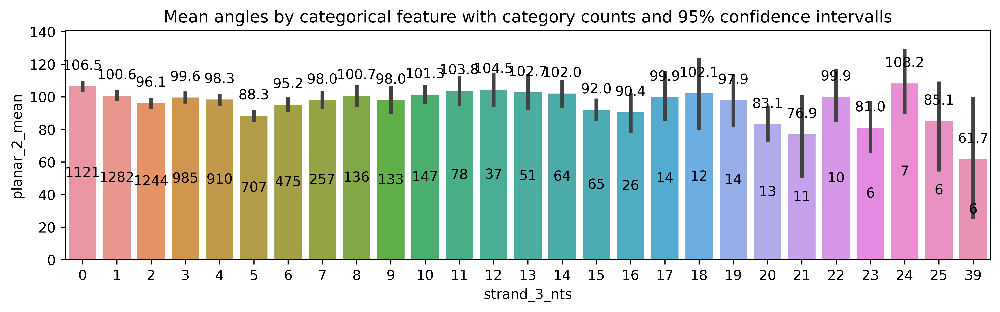

In [6]:
feature_barplot(agg, 'strand_1_nts', feature='planar_2_mean')
feature_barplot(agg, 'strand_2_nts', feature='planar_2_mean')
feature_barplot(agg, 'strand_3_nts', feature='planar_2_mean')

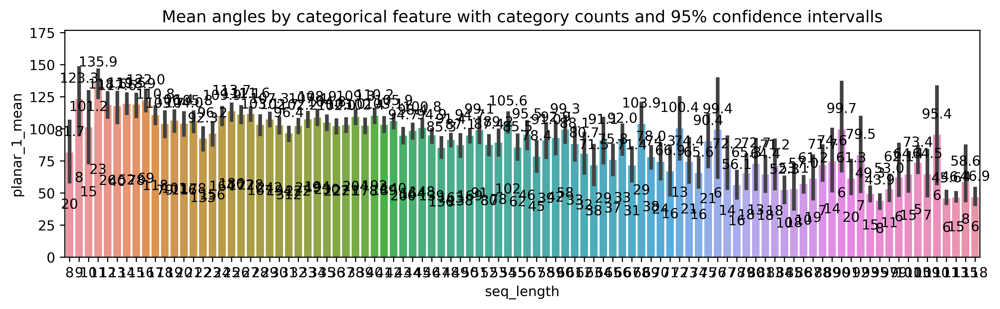

In [7]:
feature_barplot(agg, 'seq_length', feature='planar_1_mean')

Wir können auch Korrellationen im Bezug auf die planaren Winkel betrachten:

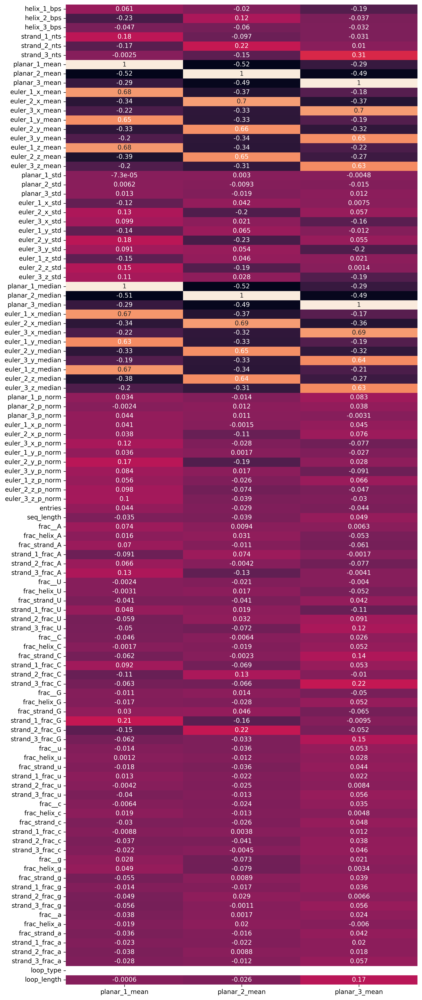

In [8]:
feature = ["planar_1_mean", "planar_2_mean", "planar_3_mean"]
method = "spearman"

fig, ax = plt.subplots(figsize=(10, 28), dpi=300)
cors = load_agg_df(way=3).corr(numeric_only=True, method=method)[feature]
_ = sns.heatmap(cors, ax=ax, annot=True, cbar=False)

Wir können jetzt langsam anfangen zu verstehen wie Winkel mit Featuren zusammenhängen und mögliche Cluster bilden. \
Relevant könnten hierfür z.B. Länge der Sequenz und ihrer einzelnen Teile (Helices/Strands sein):

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


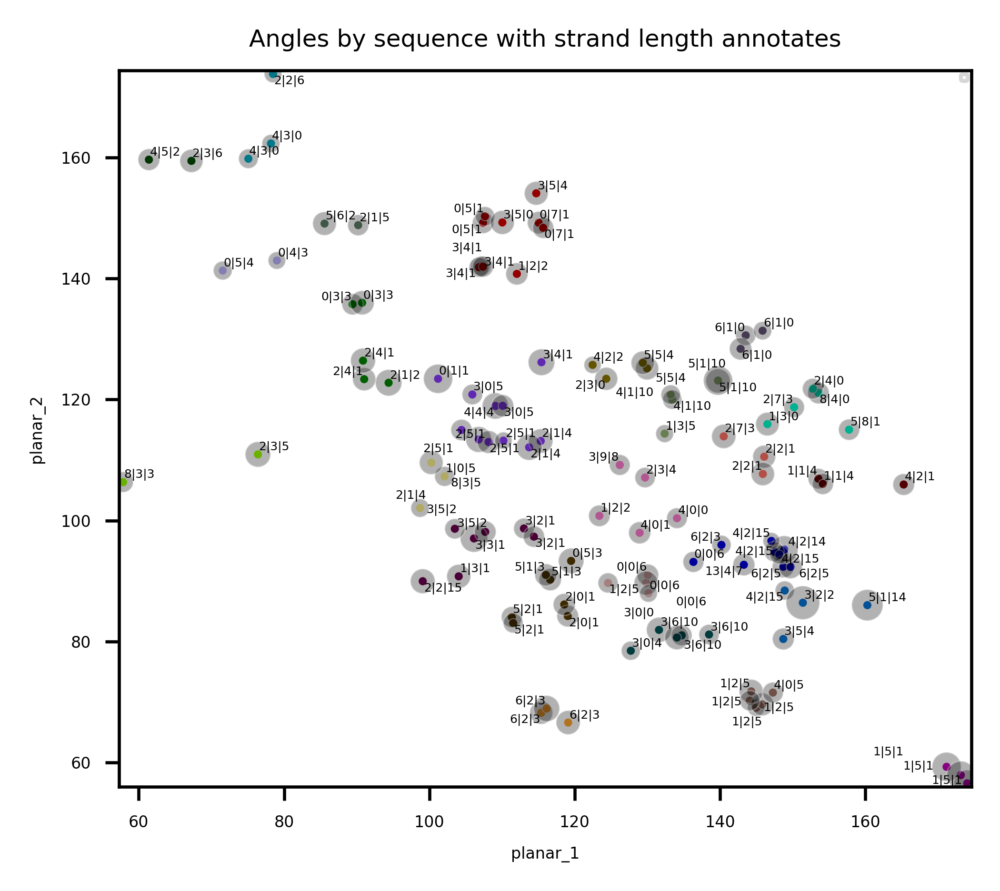

In [9]:
kwargs = dict(df=df.way3, ls=3, min_n=50, label_kind="strand length")
cluster_planar_angles(**kwargs)  # Plots only Sequences with >50 occurences

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


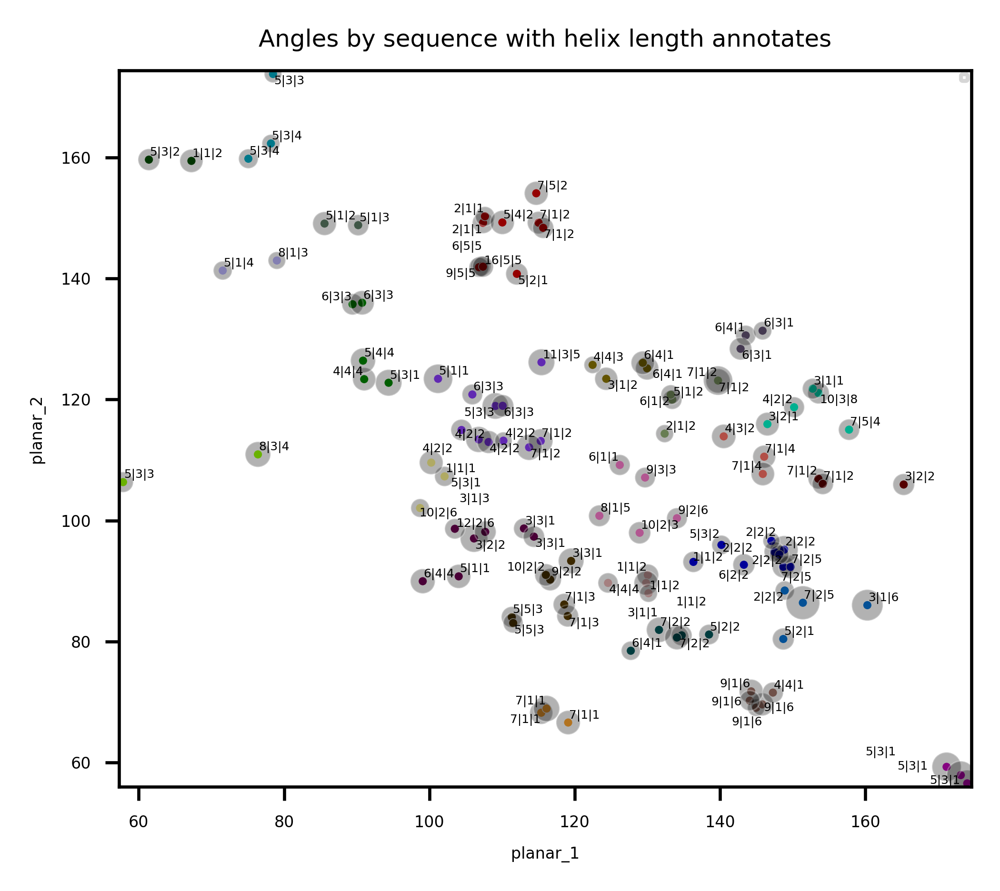

In [10]:
kwargs['label_kind'] = "helix length"
cluster_planar_angles(**kwargs)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


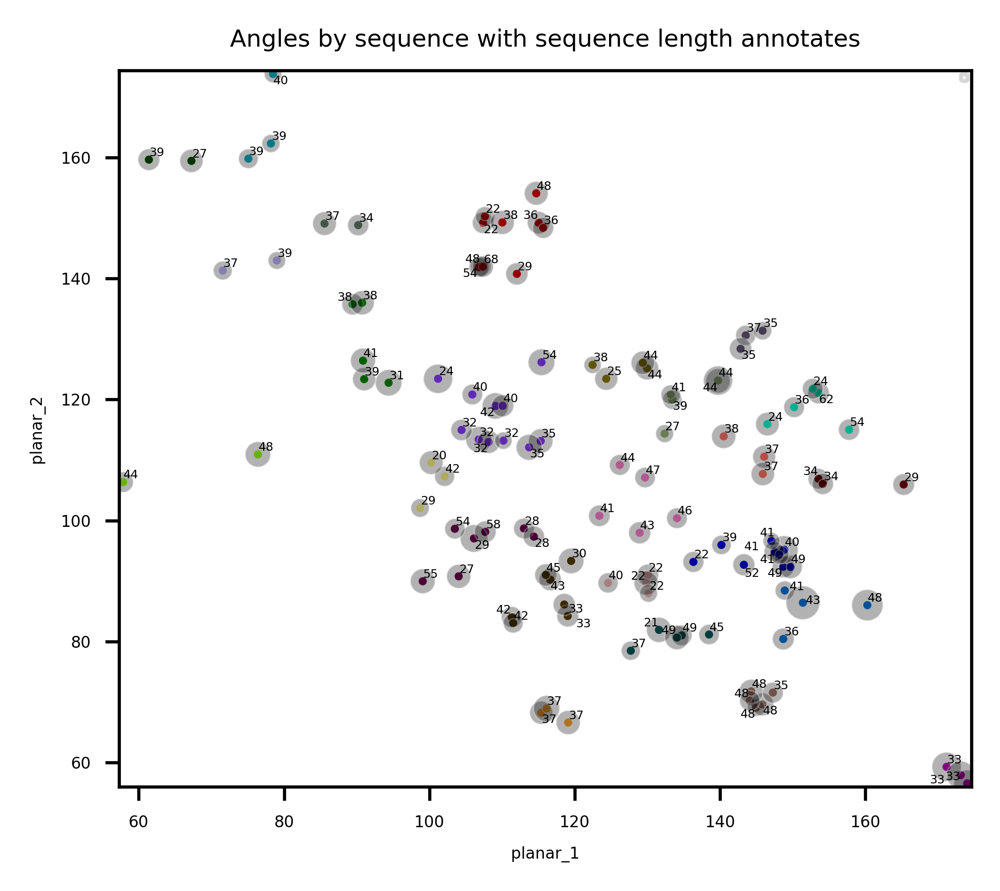

In [11]:
kwargs['label_kind'] = "sequence length"
cluster_planar_angles(**kwargs)

Bis jetzt war alles auf loop_type=3 beschränkt. Im Folgenden sieht man aber, dass die anderen loop_types eher noch eindeutiger clustern:

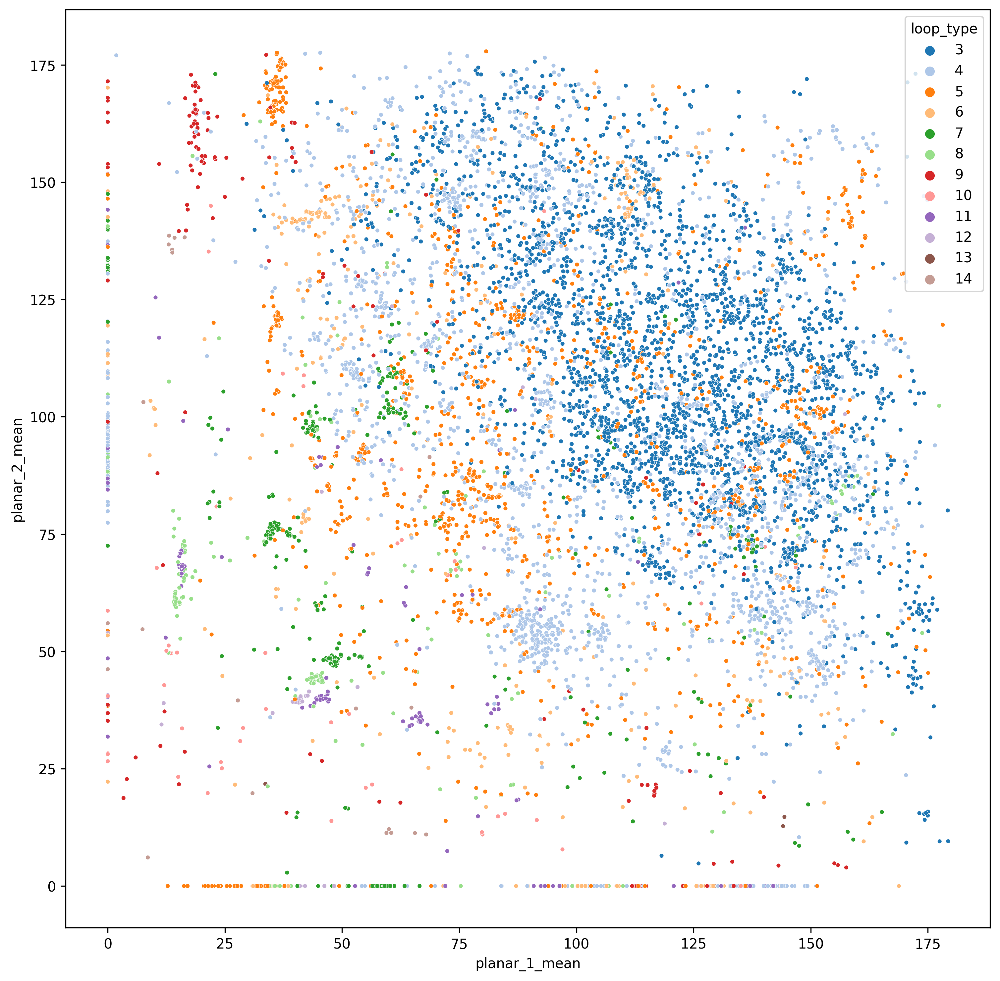

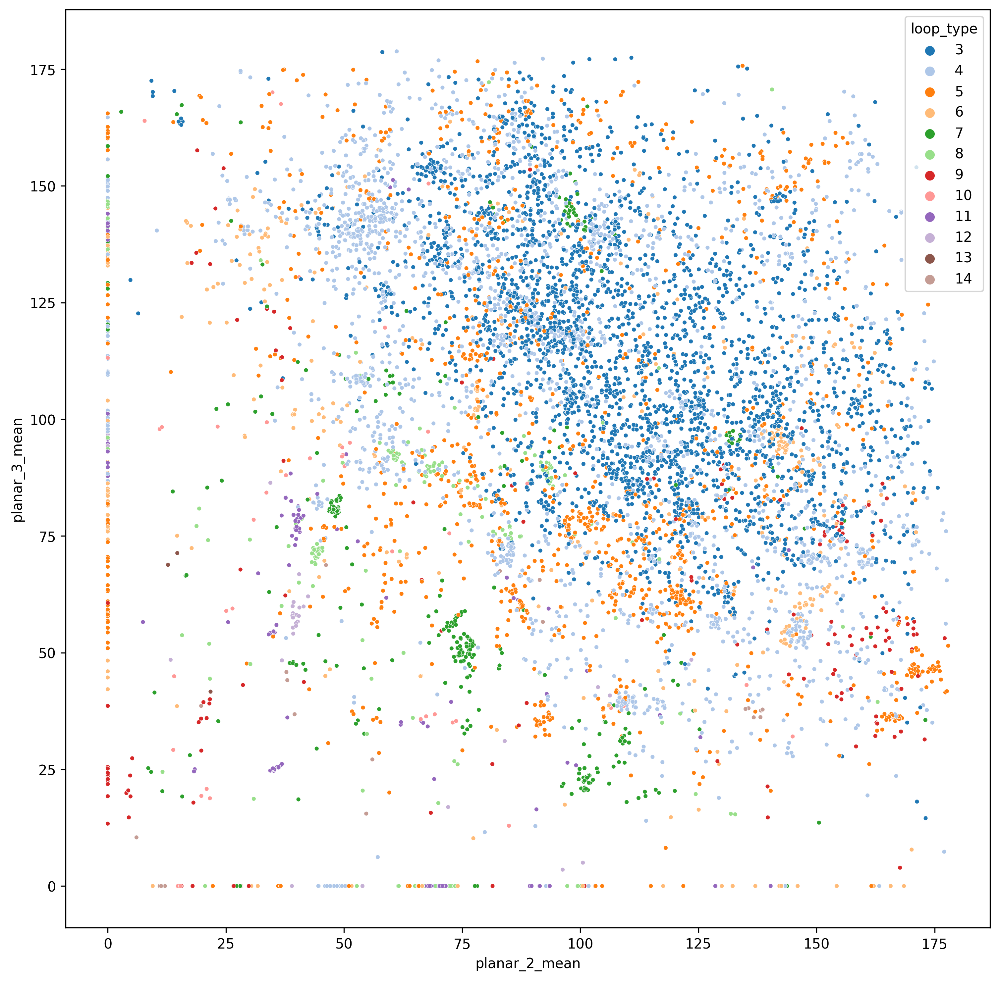

In [12]:
agg_all = load_agg_df()

fig, ax = plt.subplots(figsize=(12, 12), dpi=300)
sns.scatterplot(data=agg_all, x='planar_1_mean', y='planar_2_mean', s=10,
                hue='loop_type', palette='tab20')

fig, ax = plt.subplots(figsize=(12, 12), dpi=300)
_ = sns.scatterplot(data=agg_all, x='planar_2_mean', y='planar_3_mean', s=10,
                    hue='loop_type', palette='tab20')


Wir können im Plot Feature farblich oder per Marker aufteilen, so sieht man Zusammenhänge:

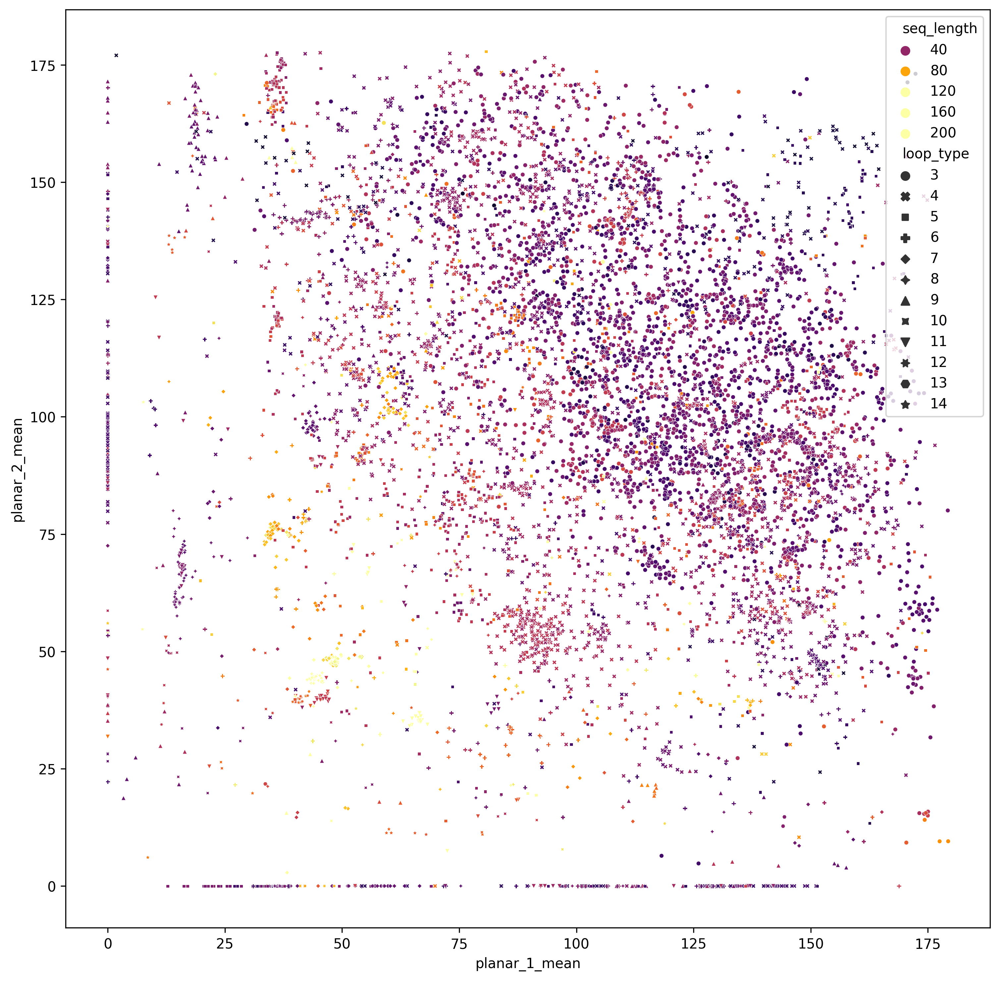

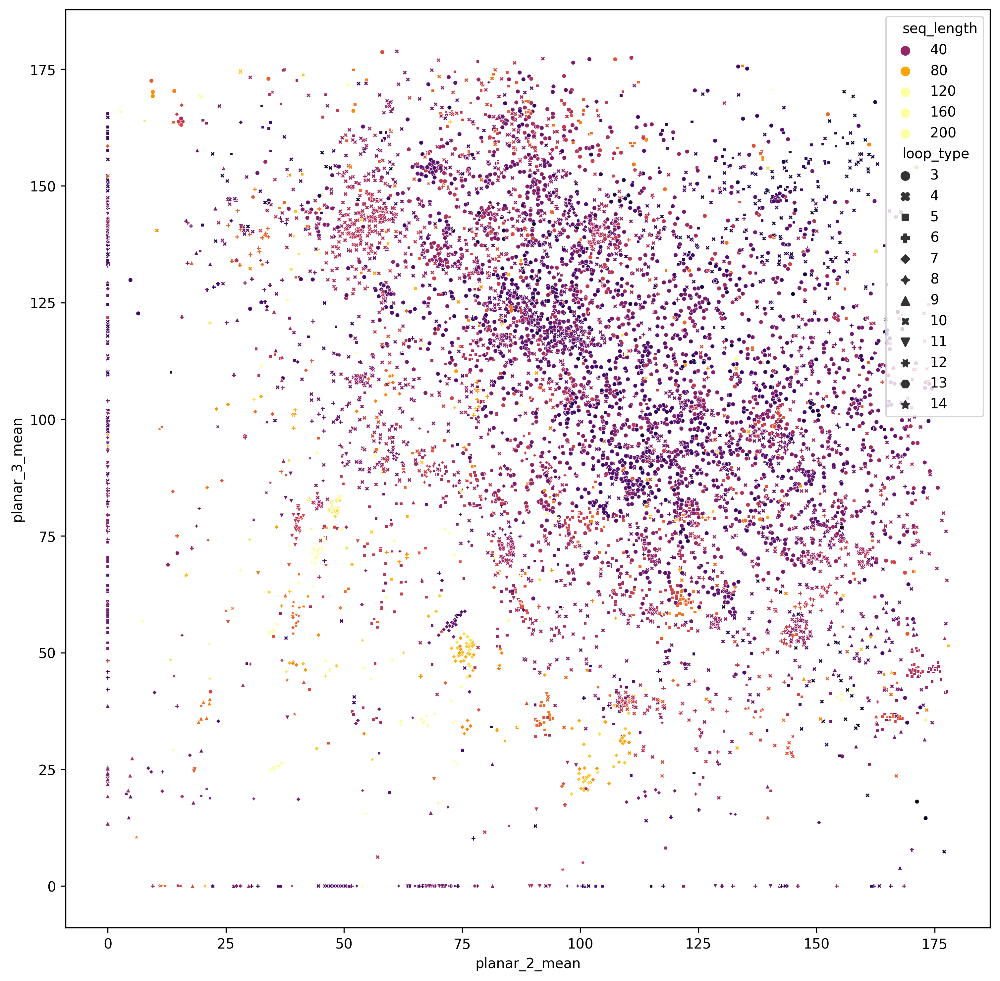

In [13]:
hue = 'seq_length'  # Feature to distinguish via color
style = 'loop_type'  # Feature to distinguish via marker
maxc = 100  # Maximum for color scale

fig, ax = plt.subplots(figsize=(12, 12), dpi=300)
sns.scatterplot(data=agg_all, x='planar_1_mean', y='planar_2_mean', s=10,
                style=style, hue=hue, palette='inferno', hue_norm=(0, maxc))

fig, ax = plt.subplots(figsize=(12, 12), dpi=300)
_ = sns.scatterplot(data=agg_all, x='planar_2_mean', y='planar_3_mean', s=10,
                    style=style, hue=hue, palette='inferno', hue_norm=(0, maxc))

Es lassen sich bei loop_types zwischen 4 und 11 diverse kleinerer Cluster und wenige größere erahnen. \
Allerdings projezierren wir hier nur auf die ersten drei Winkel, wir brauchen also dringend ein vernünftiges Clustering in höherer Dimension, siehe dazu clustering.ipynb.